In [1]:
# Necessary Library imports
from CameraCalibration import cameraCalib
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PrespectiveTransform import prespectiveTransform
from LaneInformation import laneInfo
from LaneDetection import LaneDetection
from glob import glob
from moviepy.editor import VideoFileClip
%matplotlib inline

Loaded calibration parameters from disk....


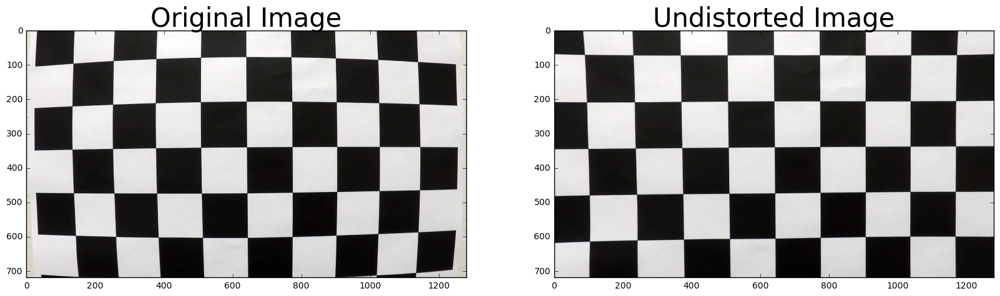

In [2]:
camera = cameraCalib()
mtx, dist = camera.get_camera_parameters()
test_file = 'camera_cal/calibration1.jpg'
camera.test_calibration(test_file)

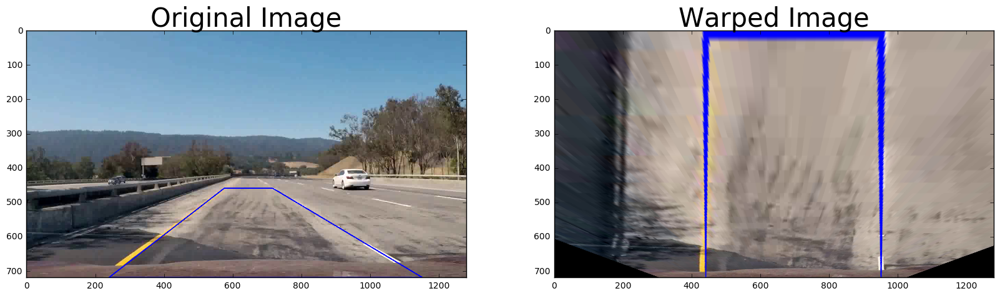

In [3]:
warp = prespectiveTransform()
test_file = 'test_images/test10.jpg'
img = cv2.imread(test_file)
warp.test_prespective_transform(img)

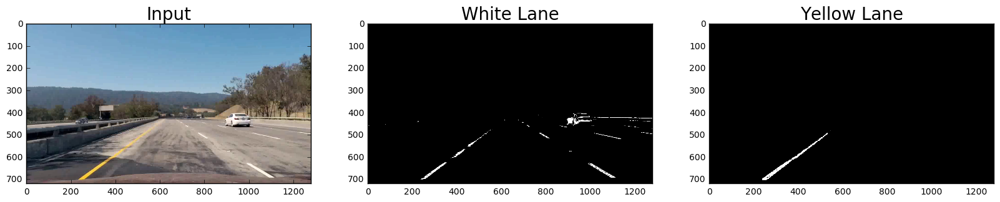

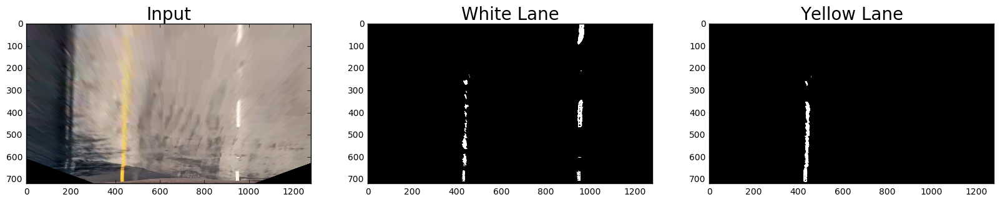

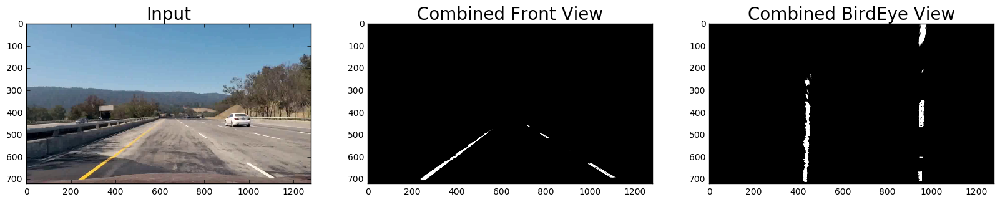

In [4]:
from LaneDetection import LaneDetection
test_file = 'test_images/test10.jpg'
img = cv2.imread(test_file)
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
lane = LaneDetection(camera, warp)
lane.extract_lane_information(img,useEdge=False, show_images=True)

In [5]:
def overlay_curve(img, edge, lanes, Minv):
    warp_zero = np.zeros_like(edge).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([lanes[0].allx, lanes[0].ally]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([lanes[1].allx, lanes[1].ally])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0]))
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)

    middle = (lanes[0].allx[-1] + lanes[1].allx[-1])//2
    veh_pos = img.shape[1]//2
    xm_per_pix = 3.7 / 700  # meteres per pixel in x dimension
    off_center = (veh_pos - middle) * xm_per_pix # Positive if on right, Negative on left

    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result, 'Radius of curvature (Left)  = %.2f m' % (laneLines[0].radius_of_curvature), (10, 40), font, 1,
                (255, 255, 255), 2, cv2.LINE_AA)
    cv2.putText(result, 'Radius of curvature (Right) = %.2f m' % (laneLines[0].radius_of_curvature), (10, 70), font, 1,
                (255, 255, 255), 2, cv2.LINE_AA)
    cv2.putText(result, 'Vehicle position : %.2f m %s of center' % (abs(off_center), 'left' if off_center < 0 else 'right'), (10, 100),
                font, 1, (255, 255, 255), 2, cv2.LINE_AA)
    return result

def pipeline(img):
    lane = LaneDetection(camera, warp)
    lane.extract_lane_information(img, useEdge=False, show_images=False)
    #if lane.condition!=1:
    laneLines[0].extract_lane_coordinates(lane.edge_bird_view, True, show_fit=False)
    laneLines[1].extract_lane_coordinates(lane.edge_bird_view, False, show_fit=False)
    result = overlay_curve(img, lane.edge_bird_view, laneLines, warp.mtx_perp_inv)
    return result

def show_images(img1, img2, title1='Input', title2='Result', figsize=(24, 9)):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)
    f.tight_layout()
    ax1.imshow(img1)
    ax1.set_title(title1, fontsize=20)
    ax2.imshow(img2)
    ax2.set_title(title2, fontsize=20)
    #f.show()
    plt.show()

test_images/straight_lines1.jpg
CPU times: user 432 ms, sys: 16 ms, total: 448 ms
Wall time: 74 ms


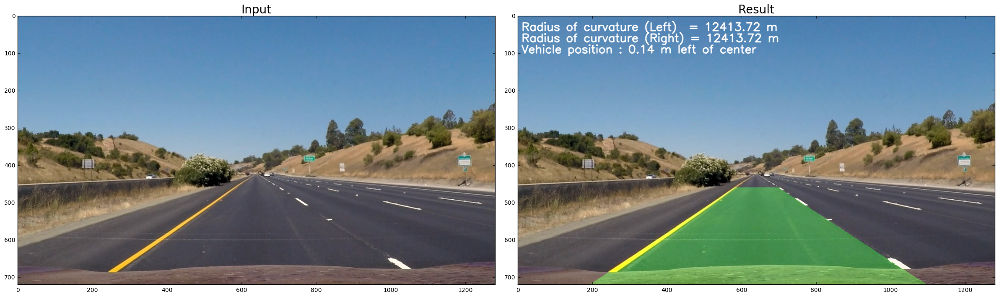

test_images/straight_lines2.jpg
CPU times: user 1.42 s, sys: 24 ms, total: 1.45 s
Wall time: 334 ms


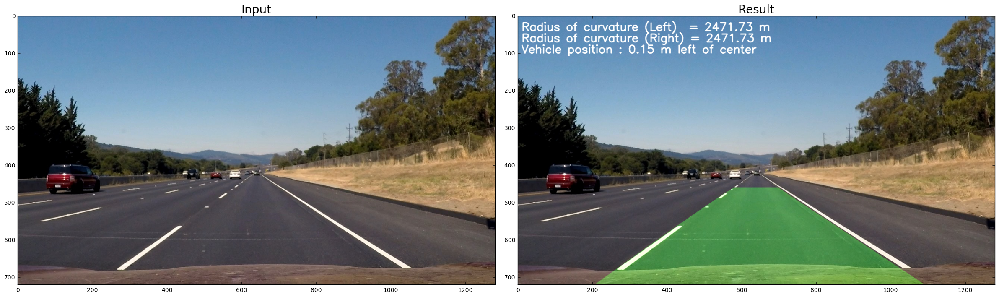

test_images/test1.jpg
CPU times: user 928 ms, sys: 0 ns, total: 928 ms
Wall time: 144 ms


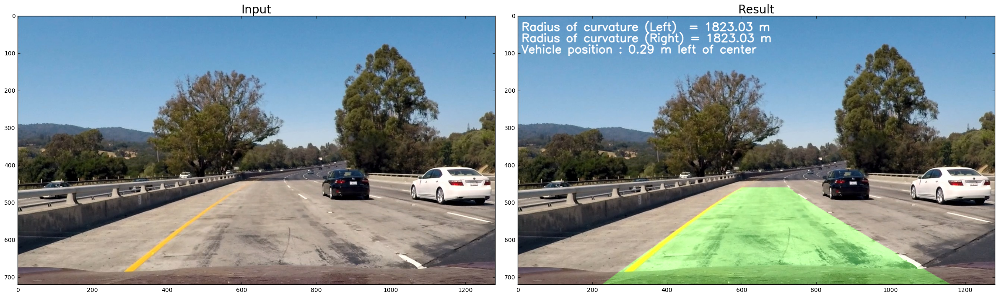

test_images/test10.jpg
CPU times: user 992 ms, sys: 12 ms, total: 1 s
Wall time: 158 ms


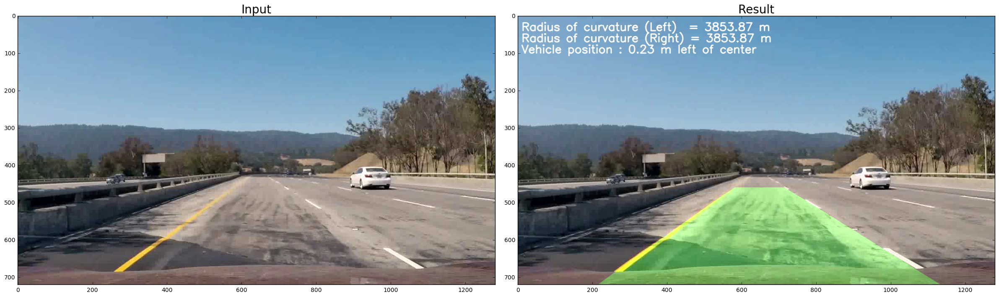

test_images/test2.jpg
CPU times: user 1 s, sys: 24 ms, total: 1.02 s
Wall time: 161 ms


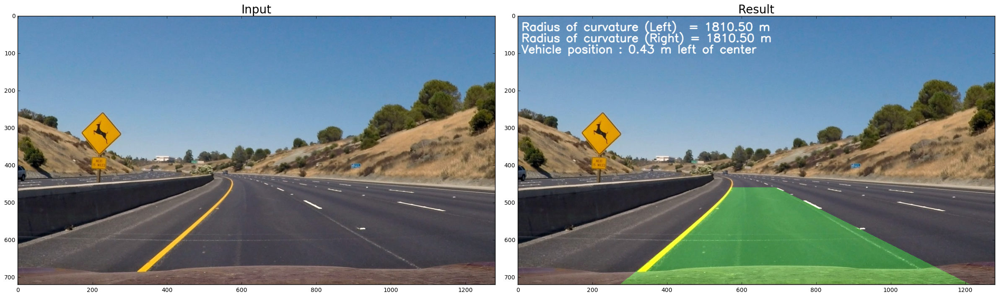

test_images/test3.jpg
CPU times: user 1.03 s, sys: 12 ms, total: 1.04 s
Wall time: 164 ms


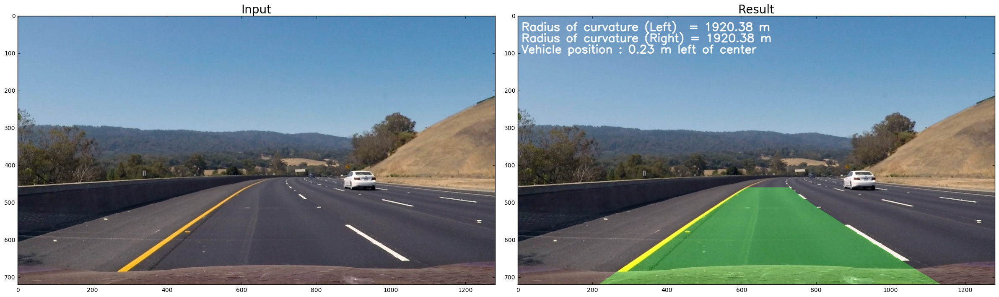

test_images/test4.jpg
CPU times: user 908 ms, sys: 4 ms, total: 912 ms
Wall time: 145 ms


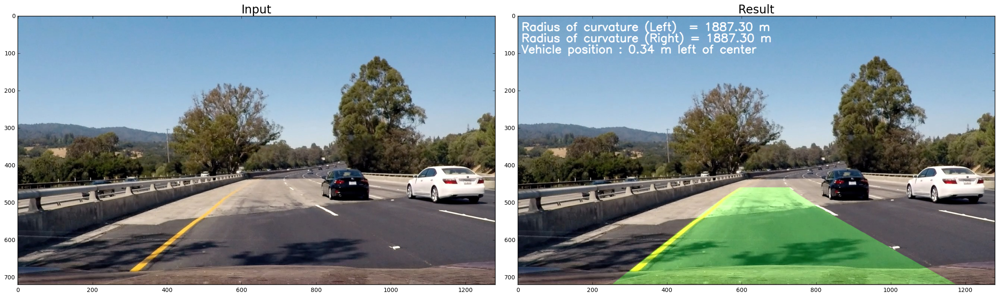

test_images/test5.jpg
CPU times: user 964 ms, sys: 8 ms, total: 972 ms
Wall time: 154 ms


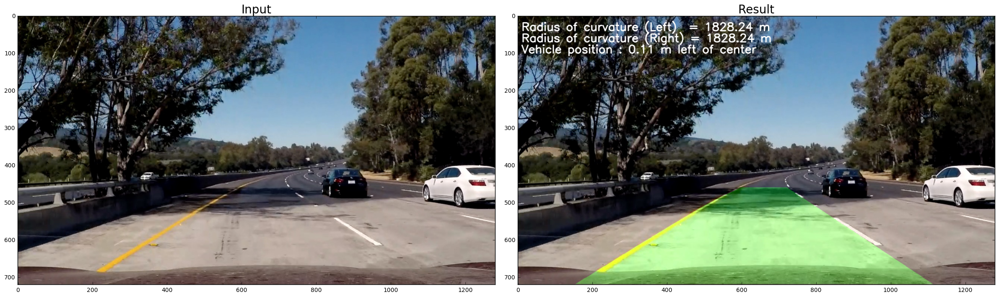

test_images/test6.jpg
CPU times: user 944 ms, sys: 0 ns, total: 944 ms
Wall time: 158 ms


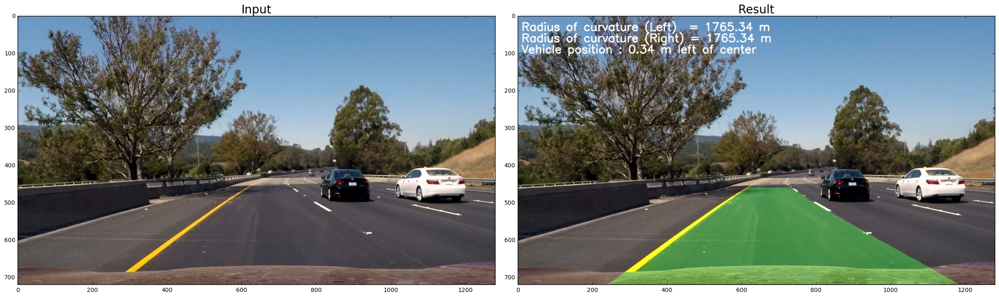

In [6]:
images_path = 'test_images/*'
image_files = sorted(glob(images_path))
laneLines = [laneInfo(), laneInfo()]
for fname in image_files:
    print(fname)
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    %time out = pipeline(img)
    show_images(img,out)

In [7]:
laneLines = [laneInfo(), laneInfo()]
yellow_output = 'project_video_out.mp4'
clip2 = VideoFileClip('project_video.mp4')
yellow_clip = clip2.fl_image(pipeline)
%time yellow_clip.write_videofile(yellow_output, audio=False)

[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4


100%|█████████▉| 1260/1261 [02:03<00:00, 10.66it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

CPU times: user 11min 41s, sys: 1.01 s, total: 11min 42s
Wall time: 2min 3s


In [8]:
from IPython.display import HTML
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(yellow_output))